## Notebook for large grid simulation output for 12 months

This notebook contains postprocessing analysis of simulations initialized on a uniform basin-wide grid, both with transport (Lagrangian) and without transport (Eulerian) It includes:
- Comparison of Lagrangian and Eulerian relative biomass increase and growth factor
- Monthly categorized plots of potential relative biomass
- Monthly plots of relative biomass difference of Lagrangian simulation compared to Eulerian simulation
- Monthly growth factor analysis
- Growth factor analysis of July 2024


In [1]:
#NOTEBOOK FOR ANALYSIS OF SARGASSUM SIMULATIONS FOR 12 START TIMES

import math
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

import trajan
import cartopy
import cartopy.crs as ccrs
from datetime import datetime, timedelta

import calculate_2DHistogram_method01 as c_H
import matplotlib.colors as mcolors
import cmocean.cm as cmo
from matplotlib import colormaps as mcolormaps


In [2]:
#Opening datasets of all Lagrangian simulations (12 months)
DSL1 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_LA_2024_01.zarr").dropna(dim='obs', how='all')
DSL2 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_LA_2024_02.zarr").dropna(dim='obs', how='all')
DSL3 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_LA_2024_03.zarr").dropna(dim='obs', how='all')
DSL4 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_LA_2024_04.zarr").dropna(dim='obs', how='all')
DSL5 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_LA_2024_05.zarr").dropna(dim='obs', how='all')
DSL6 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_LA_2024_06.zarr").dropna(dim='obs', how='all')
DSL7 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_LA_2024_07.zarr").dropna(dim='obs', how='all')
DSL8 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_LA_2024_08.zarr").dropna(dim='obs', how='all')
DSL9 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_LA_2024_09.zarr").dropna(dim='obs', how='all')
DSL10 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_LA_2024_10.zarr").dropna(dim='obs', how='all')
DSL11 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_LA_2024_11.zarr").dropna(dim='obs', how='all')
DSL12 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_LA_2024_12.zarr").dropna(dim='obs', how='all')

#Opening datasets of all Eulerian simulations (12 months)
DSE1 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_EU_2024_01.zarr").dropna(dim='obs', how='all')
DSE2 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_EU_2024_02.zarr").dropna(dim='obs', how='all')
DSE3 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_EU_2024_03.zarr").dropna(dim='obs', how='all')
DSE4 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_EU_2024_04.zarr").dropna(dim='obs', how='all')
DSE5 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_EU_2024_05.zarr").dropna(dim='obs', how='all')
DSE6 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_EU_2024_06.zarr").dropna(dim='obs', how='all')
DSE7 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_EU_2024_07.zarr").dropna(dim='obs', how='all')
DSE8 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_EU_2024_08.zarr").dropna(dim='obs', how='all')
DSE9 = xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_EU_2024_09.zarr").dropna(dim='obs', how='all')
DSE10= xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_EU_2024_10.zarr").dropna(dim='obs', how='all')
DSE11= xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_EU_2024_11.zarr").dropna(dim='obs', how='all')
DSE12= xr.open_zarr("/storage/shared/oceanparcels/output_data/data_Elena/FINAL/SIM1_LG_EU_2024_12.zarr").dropna(dim='obs', how='all')

#Starttime definitions for every month
starttimejan = datetime(2024,1,1)
starttimefeb = datetime(2024,2,1)
starttimemar = datetime(2024,3,1)
starttimeapr = datetime(2024,4,1)
starttimemay = datetime(2024,5,1)
starttimejun = datetime(2024,6,1)
starttimejul = datetime(2024,7,1)
starttimeaug = datetime(2024,8,1)
starttimesep = datetime(2024,9,1)
starttimeoct = datetime(2024,10,1)
starttimenov = datetime(2024,11,1)
starttimedec = datetime(2024,12,1)

#Definition of time array in hours and days
time_in_hours = ((DSL1['time']-DSL1['time'][:,0]).astype("timedelta64[h]"))
time_in_days = ((DSL1['time'] - DSL1['time'][:, 0]).astype("timedelta64[h]")).astype(float) / 24

print('Size of DSL1 file:' , DSL1.sizes, ' and of DSE1 file:', DSE1.sizes)

Size of DSL1 file: Frozen({'trajectory': 49631, 'obs': 372})  and of DSE1 file: Frozen({'trajectory': 49631, 'obs': 372})


In [5]:
#Preparing data
months = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
DSLs = [DSL1, DSL2, DSL3, DSL4, DSL5, DSL6, DSL7, DSL8, DSL9, DSL10, DSL11, DSL12]
DSEs = [DSE1, DSE2, DSE3, DSE4, DSE5, DSE6, DSE7, DSE8, DSE9, DSE10, DSE11, DSE12]

for ds in DSLs:
    print(ds.sizes, len(ds.obs))
print('-------------------------------------------')
for ds in DSEs:
    print(ds.sizes, len(ds.obs))

Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 366}) 366
-------------------------------------------
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 372}) 372
Frozen({'trajectory': 49631, 'obs': 

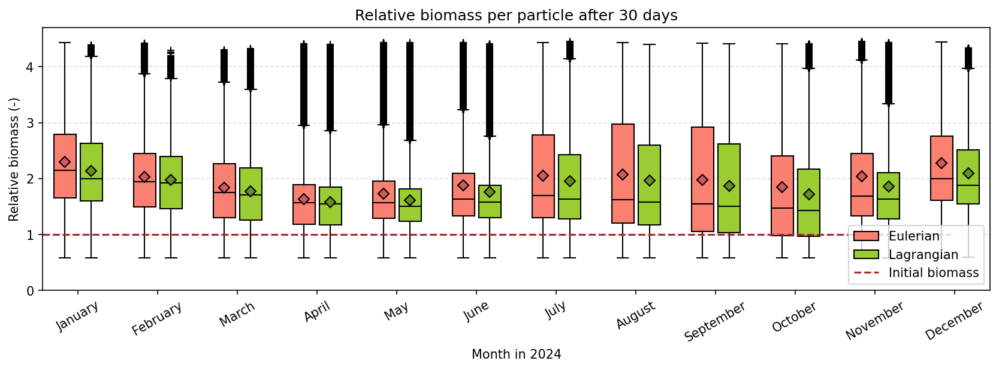

In [6]:
#Extracting last timestep weights
boxplot_list_DSL = [L.isel(obs=-1)['biomass_SF3'] for L in DSLs] 
boxplot_list_DSE = [E.isel(obs=-1)['biomass_SF3'] for E in DSEs]

#X positions for each month
positions_DSE = np.arange(len(months)) * 1.8  # spacing between month groups
positions_DSL = positions_DSE + 0.6           # offset for second box (DSE)

#Creating plot
plt.figure(figsize=(11, 4), constrained_layout=True, dpi=150)

#Settings for means
meansettingsE = dict(marker='D', markeredgecolor='black', markerfacecolor='indianred')
meansettingsL = dict(marker='D', markeredgecolor='black', markerfacecolor='olivedrab')

#Boxplots for both groups
plt.boxplot(boxplot_list_DSE, positions=positions_DSE, widths=0.5, label='Eulerian', patch_artist=True,
            boxprops=dict(facecolor='salmon'), medianprops=dict(color='black'), sym='+', showmeans=True, meanprops=meansettingsE)
plt.boxplot(boxplot_list_DSL, positions=positions_DSL, widths=0.5, label='Lagrangian', patch_artist=True,
            boxprops=dict(facecolor='yellowgreen'), medianprops=dict(color='black'), sym='+', showmeans=True, meanprops=meansettingsL )

plt.xticks(positions_DSE + 0.3, months, rotation=30)
plt.xlabel('Month in 2024')
plt.hlines(1, xmin=-0.5, xmax=20, label='Initial biomass', color='Brown' , linestyle='--' )
plt.ylabel('Relative biomass (-)')
plt.title(f'Relative biomass per particle after 30 days')
plt.legend( loc='lower right')
plt.ylim(0,4.7)
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.show()

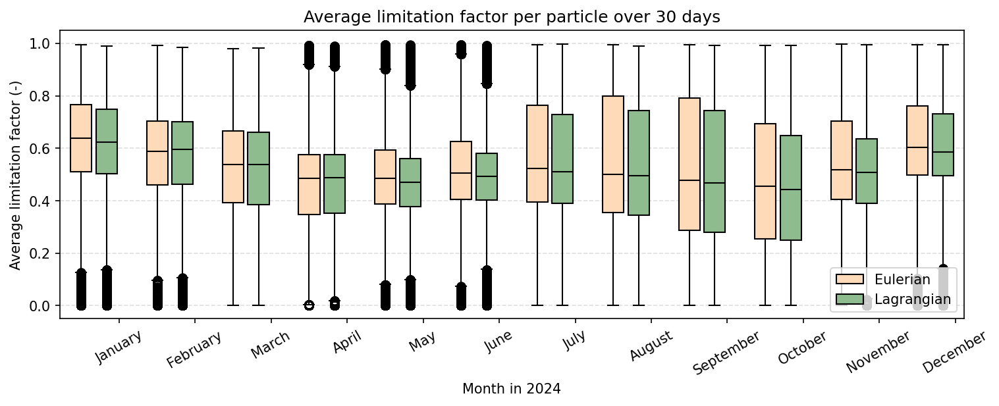

In [ ]:
#Extracting last timestep weights
boxplot_list_DSL_lim = [L['limitation'].mean(dim='obs') for L in DSLs] 
boxplot_list_DSE_lim = [E['limitation'].mean(dim='obs') for E in DSEs]

#X positions for each month
positions_DSE = np.arange(len(months)) * 1.8  # spacing between month groups
positions_DSL = positions_DSE + 0.6           # offset for second box (DSE)

#Creating plot
plt.figure(figsize=(10, 4), constrained_layout=True, dpi=150)

#Boxplots for both groups
plt.boxplot(boxplot_list_DSE_lim, positions=positions_DSE, widths=0.5, label='Eulerian', patch_artist=True,
            boxprops=dict(facecolor='peachpuff'), medianprops=dict(color='black'))
plt.boxplot(boxplot_list_DSL_lim, positions=positions_DSL, widths=0.5, label='Lagrangian', patch_artist=True,
            boxprops=dict(facecolor='darkseagreen'), medianprops=dict(color='black'))

plt.xticks(positions_DSL + 0.3, months, rotation=30)
plt.xlabel('Month in 2024')
plt.ylabel('Average limitation factor (-)')
plt.title(f'Average limitation factor per particle over 30 days')
plt.legend( loc='lower right')
plt.ylim(-0.05,1.05)
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.show()

(12, 366)


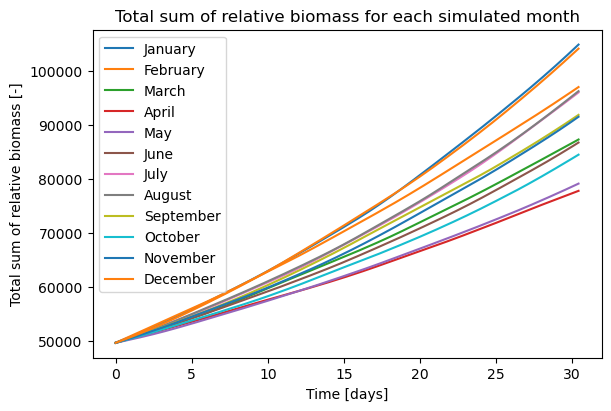

In [7]:
#Calculating the sum of relative biomass at at each moment in time
weights = [L['biomass_SF3'][:,:366].sum(dim='trajectory')   for L in DSLs] 
weights = np.array(weights)

print(np.shape(weights))

weightplot = plt.figure(figsize=(6,4), constrained_layout=True)
for i in range(len(weights)):
    plt.plot(time_in_days[0,:366], weights[i,:366], label = f'{months[i]}')
plt.xlabel('Time [days]')
plt.ylabel('Total sum of relative biomass [-]')
plt.title('Total sum of relative biomass for each simulated month')
plt.legend()
plt.show()

In [8]:
import geopandas as gpd
import shapely

def in_polygon_function(ds, poly):
    """Return a boolean DataArray marking points inside the polygon."""
    # Create shapely Point objects for all (lon, lat) pairs
    points = shapely.points(ds.lon, ds.lat)

    # Vectorized containment check (returns a boolean NumPy array)
    mask = shapely.contains(poly, points)

    # Wrap it back into an xarray DataArray with original coordinates
    return xr.DataArray(mask, coords=ds.coords)


relative_list = []

def amount_in_car(input_dataset):
    caribbean_poly = gpd.read_file("CARIBBEAN_polygon.shp")
    data_in_polygon = in_polygon_function(input_dataset, caribbean_poly.geometry.iloc[0])
    # Count how many are True at obs = 0
    n_true_start = data_in_polygon.isel(obs=0).sum().item()

    # Count how many are True at the last obs
    n_true_end = data_in_polygon.isel(obs=-1).sum().item()

    print(f"True at obs=0, so amount of particles in Car initially: {n_true_start}")
    print(f"True at last obs, so amount of particles in Car after simulation: {n_true_end}")

    total = input_dataset.sizes["trajectory"]
    print(f"Start: {n_true_start/total:.3%}")
    print(f"End:   {n_true_end/total:.3%}")
    print(f"Relative:   {(n_true_end-n_true_start)/total:.3%}")
    relative_list.append((n_true_end-n_true_start)/total)
    
    print('')

    return data_in_polygon

for i in DSLs:
    amount_in_car(i)

True at obs=0, so amount of particles in Car initially: 3982
True at last obs, so amount of particles in Car after simulation: 5696
Start: 8.023%
End:   11.477%
Relative:   3.453%

True at obs=0, so amount of particles in Car initially: 3982
True at last obs, so amount of particles in Car after simulation: 5653
Start: 8.023%
End:   11.390%
Relative:   3.367%

True at obs=0, so amount of particles in Car initially: 3982
True at last obs, so amount of particles in Car after simulation: 5435
Start: 8.023%
End:   10.951%
Relative:   2.928%

True at obs=0, so amount of particles in Car initially: 3982
True at last obs, so amount of particles in Car after simulation: 5428
Start: 8.023%
End:   10.937%
Relative:   2.914%

True at obs=0, so amount of particles in Car initially: 3982
True at last obs, so amount of particles in Car after simulation: 5039
Start: 8.023%
End:   10.153%
Relative:   2.130%

True at obs=0, so amount of particles in Car initially: 3982
True at last obs, so amount of par

[3.453486732082771, 3.3668473333199014, 2.9276057302895366, 2.913501642118837, 2.1297173137756644, 2.2465797586186054, 2.762386411718482, 2.3090407205174186, 1.388245249944591, 1.8254719832362838, 1.8899478148737683, 3.2721484556023457]
[3.453486732082771, 3.3668473333199014, 2.9276057302895366, 2.913501642118837, 2.1297173137756644, 2.2465797586186054, 2.762386411718482, 2.3090407205174186, 1.388245249944591, 1.8254719832362838, 1.8899478148737683, 3.2721484556023457]


/tmp/ipykernel_8916/516385418.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(months, rotation=20)


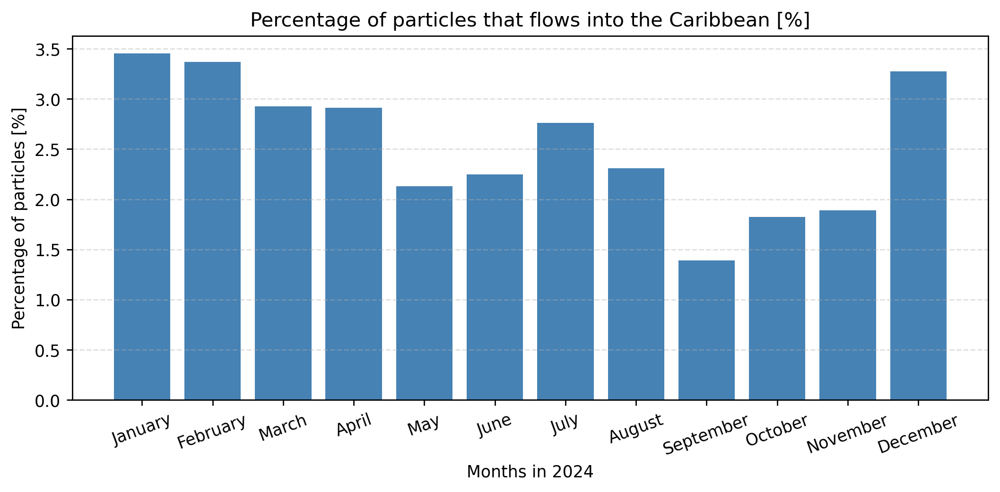

In [35]:
print(relative_list[0:12])
print(relative_list)

relative_list_perc = relative_list


for i in range(len(relative_list)):
    relative_list_perc[i] = relative_list[i]

fig, ax = plt.subplots(figsize=(10,4), dpi = 250)
ax.grid(axis='y', linestyle='--', alpha=0.4)
ax.bar(months, relative_list_perc, color='steelblue')

ax.set_ylabel('Percentage of particles [%]')
ax.set_xlabel('Months in 2024')
ax.set_title('Percentage of particles that flows into the Caribbean [%]')
ax.set_xticklabels(months, rotation=20)

plt.show()

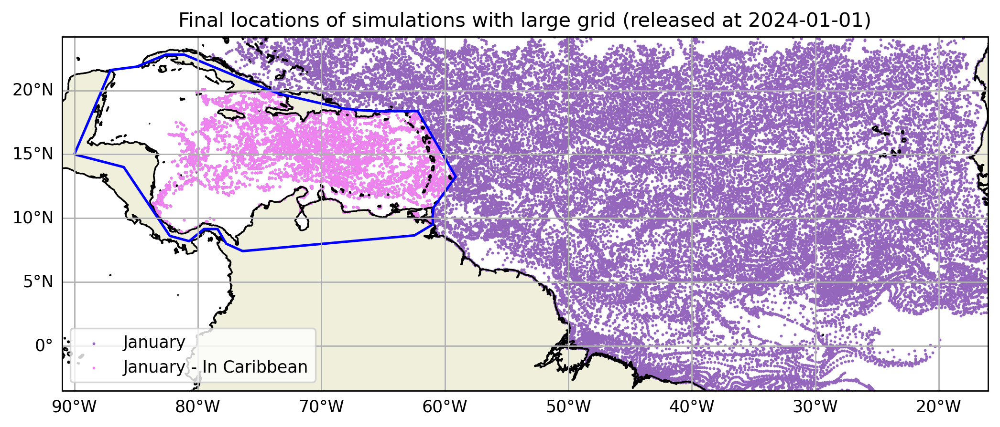

In [12]:
import geopandas as gpd
import shapely

gdf_poly = gpd.read_file( "CARIBBEAN/CARIBBEAN_polygon.shp" )


def in_polygon_function(ds, poly):
    """Return a boolean DataArray marking points inside the polygon."""
    #Create shapely Point objects for all (lon, lat) pairs
    points = shapely.points(ds.lon, ds.lat)

    #Vectorized containment check (returns a boolean NumPy array)
    mask = shapely.contains(poly, points)

    #Wrap it back into an xarray DataArray with original coordinates
    return xr.DataArray(mask, coords=ds.coords)

january_in_polygon = in_polygon_function(DSL1, gdf_poly.geometry.iloc[0])


pincar = DSL1.where(january_in_polygon, drop=False)


#Figure for plotting trajectories
fig2 = plt.figure(figsize = (10,6), dpi=250)
ax = plt.axes(projection=ccrs.PlateCarree())

#End locations scatterplot
#eplot = ax.scatter(DSL1.lon[:,-1], DSL1.lat[:,-1], s = 0.5 ,color='tab:red', label= 'Jan transport') #Transposing lon and lat arrays!
eplot = ax.scatter(DSL1.lon[:,-1], DSL1.lat[:,-1], s = 0.5 ,color='tab:purple', label = 'January') #Transposing lon and lat arrays!

pplot = ax.scatter(pincar.lon[:,-1], pincar.lat[:,-1], s = 0.5, color= 'violet', label='January - In Caribbean')

ax.add_feature(cartopy.feature.COASTLINE.with_scale('10m'))
ax.add_feature(cartopy.feature.LAND.with_scale('10m'))
gdf_poly.boundary.plot(ax=ax, color='blue')
ax.gridlines(draw_labels=['left','bottom'], zorder=0)
ax.set_title(f'Final locations of simulations with large grid (released at {starttimejan.date()})')
ax.set_extent([-91,-16,-3,20])
ax.legend()
plt.show()

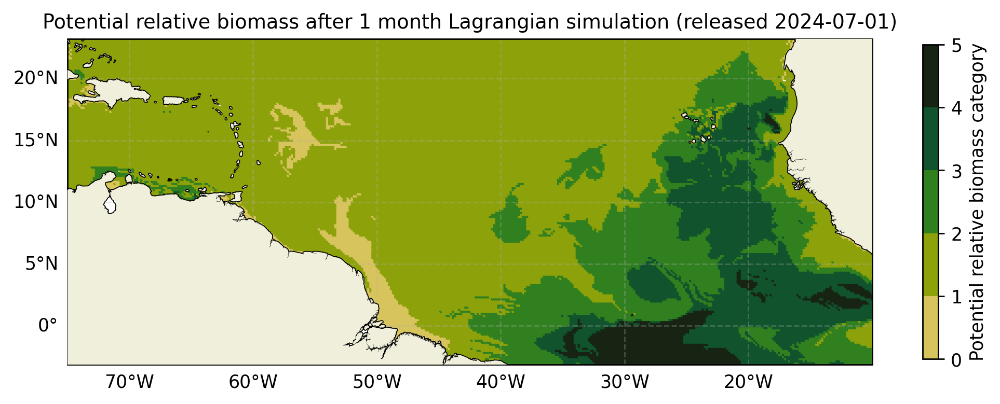

In [21]:
def categorized_weight_plot(DATA,  DIV, COLORMAP, STARTTIME, FINAL=True):
    #Categorizing based on weight and multiplying by category step size #SO THIS VALUE IS THE UPPER BOUNDARY OF THE BIN THAT THE PARTICLE WEIGHT IS CLASSIFIED IN!!!!
    categorized_id = np.digitize(DATA.biomass_SF3, DIV, right=False) #get bin indices for each weight (np.digitize gives the bin index of each weight)
    categorized_upper = DIV[categorized_id]
    categorized_lower = DIV[categorized_id - 1]
    DATA["biomass_SF3_categorized"] = (DATA.biomass_SF3.dims, categorized_lower) #Stores lower boundary of category that particle weight is in in dataset

    #Settings for the colormap and colorbar
    number_of_bins = len(DIV)
    boundaries = DIV
    #colormap = plt.cm.get_cmap('plasma', number_of_bins )
    #colormap = plt.cm.get_cmap('YlGnBu', number_of_bins )
    #norm = mcolors.BoundaryNorm(boundaries[:], number_of_bins)

    colormap = COLORMAP
    norm = mcolors.BoundaryNorm(boundaries[:], ncolors=colormap.N, clip=False)



    #FIGURE
    fig = plt.figure(figsize = (10,7), dpi=250)
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.gridlines(draw_labels=['left','bottom'], zorder=2, alpha=0.3, linestyle='--')

    if FINAL == True:
        cscat = ax.scatter(DATA.lon[:,-1], DATA.lat[:,-1], c = DATA.biomass_SF3_categorized[:,-1].values,
        cmap=colormap, norm=norm, s=1, linewidth=0, transform=ccrs.PlateCarree(), zorder=1)
    else:
    #Colored scatter plot with STARTING lon, lat and FINAL values of the categorized weight
        cscat = ax.scatter(DATA.lon[:,0], DATA.lat[:,0], c = DATA.biomass_SF3_categorized[:,-1].values,
        cmap=colormap, norm=norm, s=3, linewidth=0, transform=ccrs.PlateCarree(), zorder=1)



    #Other figure settings
    ax.add_feature(cartopy.feature.COASTLINE.with_scale('10m'), zorder=2)
    ax.add_feature(cartopy.feature.LAND.with_scale('10m'),zorder=3)
    ax.set_title(f'Potential relative biomass after 1 month Lagrangian simulation (released {starttimejul.date()})',fontsize=11)
    #ax.set_extent([-78,-15,-4,19])
    #ax.set_extent([-75,-18,-3,17])
    ax.set_extent([-75, -10, -3, 20])
    cbar = plt.colorbar(cscat, ax=ax, orientation='vertical', label='Potential relative biomass category', shrink=0.45)
    return plt.show()

div = np.linspace(0, 5, 6)   #creating 9 equally spaced bin edges between 0 and 400
import cmocean
newcmap = cmocean.tools.crop_by_percent(cmo.speed, 20, which='min', N=None)
newcmap2 = cmocean.tools.crop_by_percent(newcmap, 5, which='max', N=None)
categorized_weight_plot(DSL7, div, newcmap, starttimejul, FINAL=False)

Div : [0. 1. 2. 3. 4. 5.]
4.3902664 0.5851631
4.287553 0.585163


4.3290396 0.585163
4.3953447 0.585163
4.4302516 0.585163
4.4089727 0.585163
4.4560456 0.585163
4.4019094 0.585163
4.415099 0.585163
4.4056406 0.585163
4.4353857 0.585163
4.3315187 0.5902549


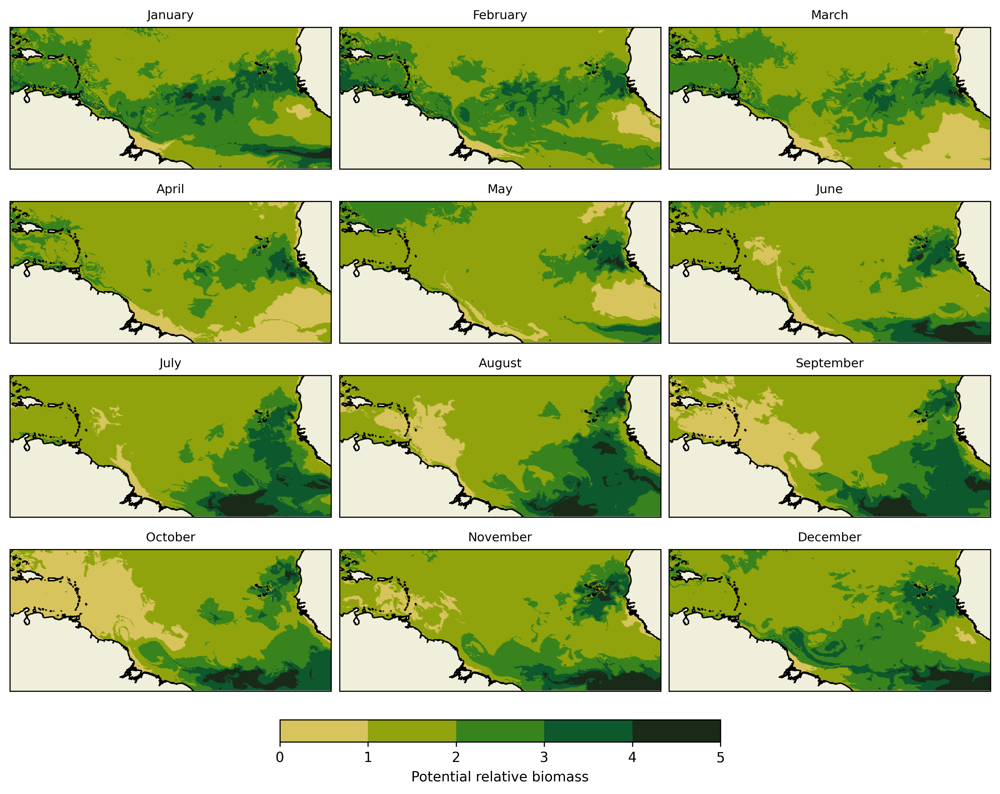

In [25]:
#FIGURE WITH CATEGORIZED BIOMASS FOR 12 MONTHS OF LAGRANGIAN SIMULATION

import cmocean
cmap1 = cmocean.tools.crop_by_percent(cmo.speed, 20, which='min', N=None)
cmap2 = cmocean.tools.crop_by_percent(cmap1, 4, which='max', N=None)

#Defining the categories
div = np.linspace(0, 5, 6)   #creating equally spaced bins (x, y, y+1)
print('Div :',div)             #
div_step = div[1]-div[0]       #calculating bin step size (interval width)

#Categorizing biomass for each month with for loop for lagrangian data
for i in range(len(DSLs)):
    biomass = DSLs[i].biomass_SF3 
    print(biomass.max().values, biomass.min().values )
    
    #Categorizing based on weight and multiplying by category step size #SO THIS VALUE IS THE UPPER BOUNDARY OF THE BIN THAT THE PARTICLE WEIGHT IS CLASSIFIED IN!!!!
    categorized_id = np.digitize(biomass, div, right=False) #get bin indices for each weight (np.digitize gives the bin index of each weight)
    categorized_upper = div[categorized_id]
    categorized_lower = np.where(
        categorized_id == 0,
        div[0],                       #if below first bin assign lowest
        div[np.clip(categorized_id - 1, 0, len(div) - 1)])  #else normal lower bound
 
    DSLs[i]["biomass"] = (DSLs[i].biomass_SF3.dims, categorized_lower) #Stores lower boundary of category that particle weight is in in dataset

number_of_bins = len(div)
boundaries = div
colormap = cmap2
norm = mcolors.BoundaryNorm(boundaries[:], ncolors=colormap.N, clip=False)

#FIGURE SETTINGS
#fig, axes = plt.subplots(3,4,     # 3 rows × 4 columns
    #figsize=(12,6),
fig, axes = plt.subplots(4,3,     # 4 rows × 3 columns
    figsize=(10,8),
    dpi=290, constrained_layout=True, subplot_kw={'projection': ccrs.PlateCarree()})

#Flattening axes array for loop
axes = axes.flatten()

#Plotting for each month
for i, ax in enumerate(axes):
    ax.set_extent([-75, -10, -4, 21])
    ax.gridlines(draw_labels=False, alpha=0.3, linestyle='--', zorder=1)

    #Scatter plot for each month
    cscat = ax.scatter(
        DSLs[i].lon[:, 0],                      #Initial location!!!
        DSLs[i].lat[:, 0],                      #Initial location!!!
        c=DSLs[i].biomass[:, -1].values,        #Final biomass of LAGRANGIAN sim!!!
        cmap=colormap,
        norm=norm,
        s=4,
        linewidth=0,
        transform=ccrs.PlateCarree(),
        zorder=2)

    #Coastlines & land
    ax.add_feature(cartopy.feature.COASTLINE.with_scale('10m'), zorder=3)
    ax.add_feature(cartopy.feature.LAND.with_scale('10m'), zorder=2)
    ax.set_title(months[i], fontsize=9)

#One colorbar for the whole figure
cbar = fig.colorbar(
    cscat,
    ax=axes,
    orientation='horizontal',
    fraction=0.032,
    pad=0.04,
    label='Potential relative biomass')

#fig.suptitle('Potential relative biomass after 1 month Lagrangian simulation plotted at initial location', fontsize = 14)
plt.savefig(f"/nethome/6903894/testing/THESIS_PLOTS/potential_biomass_12.pdf", format="pdf", bbox_inches="tight")
plt.savefig(f"/nethome/6903894/testing/THESIS_PLOTS/potential_biomass_12.png", format="png", bbox_inches="tight")
plt.show()

In [13]:
#ESTIMATING DIFFERENCE OF BIOMASS GROWTH BETWEEN EULERIAN AND LAGRANGIAN SIMULATIONS 
biomass_difference = DSL1.biomass_SF3 - DSE1.biomass_SF3 #transport - no transport #LAGRANGIAN - EULERIAN

max_wd = np.nanmax(biomass_difference) #if weight difference is positive: transport means larger growth
min_wd = np.nanmin(biomass_difference) #if weight difference is negative: no transport means larger growth
print('MAX: ', max_wd, ' MIN: ',min_wd)

DSL1['biomass_difference'] = (DSL1.biomass_SF3.dims, biomass_difference.data)



MAX:  2.4916716  MIN:  -3.269474


2.4916716 -3.269474
3.0737357 -3.2709813
2.7881584 -3.1387253
2.1581843 -3.2866497
1.5213515 -3.3639169
1.8545003 -3.2004657
1.9064034 -3.2124987
1.6420469 -2.99232
2.6968 -2.9643598
3.091679 -3.0781953
2.2356744 -3.3390915
2.0815847 -2.979391


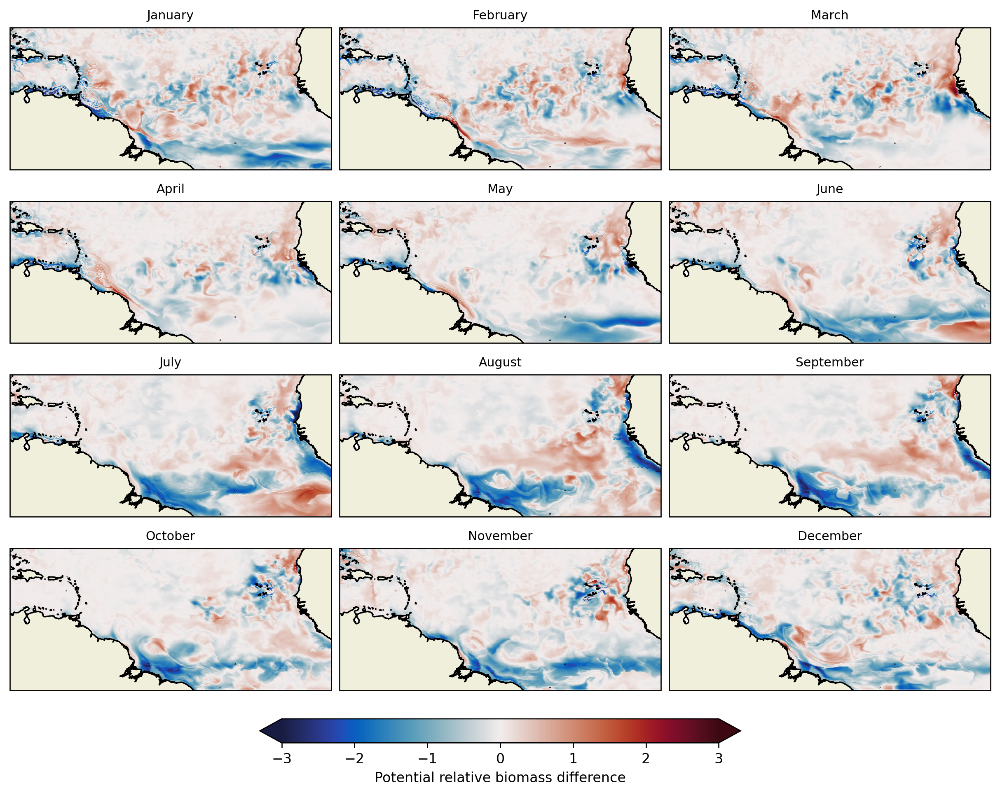

In [33]:
#Looping over each month to estimate the biomass growth difference between Eulerian and Lagrangian simulations
for i in range(len(DSLs)):
    biomass_difference = DSLs[i].biomass_SF3 - DSEs[i].biomass_SF3  #transport - no transport #LAGRANGIAN - EULERIAN
    print(biomass_difference.max().values, biomass_difference.min().values )
 
    DSLs[i]["biomass_difference"] = (DSLs[i].biomass_SF3.dims, biomass_difference.data) #Stores lower boundary of category that particle weight is in in dataset

#FIGURE SETTINGS
fig, axes = plt.subplots(4, 3 ,   # 3 rows × 4 columns
    figsize=(10,8),
    dpi=240, constrained_layout=True, subplot_kw={'projection': ccrs.PlateCarree()})
colormap = cmo.balance

#Flattening axes array for loop
axes = axes.flatten()

#Plotting for each month
for i, ax in enumerate(axes):
    ax.set_extent([-75, -10, -4, 21])
    ax.gridlines(draw_labels=False, alpha=0.3, linestyle='--', zorder=1)

    #Scatter plot for month i
    cscat = ax.scatter(
        DSEs[i].lon[:, -1], #loc
        DSEs[i].lat[:, -1], #loc
        c=DSLs[i].biomass_difference[:, -1].values,
        cmap=colormap, s=4, linewidth=0, transform=ccrs.PlateCarree(), zorder=2, 
        vmin=-3, vmax=3 
        )

    #Coastlines, land & subfigure title per month i
    ax.add_feature(cartopy.feature.COASTLINE.with_scale('10m'), zorder=3)
    ax.add_feature(cartopy.feature.LAND.with_scale('10m'), zorder=2)
    ax.set_title(months[i], fontsize=9)

#Colorbar and title for all months
cbar = fig.colorbar(
    cscat, ax=axes, orientation='horizontal', fraction=0.035, pad=0.04, 
    label='Potential relative biomass difference', extend = 'both')
#fig.suptitle('Relative biomass difference (LAGRANGIAN - EULERIAN) after 1 month', fontsize = 12)

plt.savefig(f"/nethome/6903894/testing/THESIS_PLOTS/Lag_Eu_plot.png", format="png", bbox_inches="tight")
plt.show()

In [23]:
#Calculating mean over time (so per trajectory) for 12 months
timemean_lim_sal =    np.array([E['lim_salinity'].mean(dim='obs')  for E in DSEs] )
timemean_lim_temp =   np.array([E['lim_temp'].mean(dim='obs')      for E in DSEs] )
timemean_lim_no3 =    np.array([E['lim_no3'].mean(dim='obs')       for E in DSEs] )
timemean_lim_E_tot =  np.array([E['limitation'].mean(dim='obs')    for E in DSEs] )

#Calculating mean over whole dataset for 12 months
mean_lim_sal =    np.array([E['lim_salinity'].mean()  for E in DSEs] )
mean_lim_temp =   np.array([E['lim_temp'].mean()      for E in DSEs] )
mean_lim_no3 =    np.array([E['lim_no3'].mean()       for E in DSEs] )
mean_lim_E_tot =  np.array([E['limitation'].mean()    for E in DSEs] )

print( type(timemean_lim_sal), 'Timemean: ', np.shape(timemean_lim_no3), 'Total mean:', np.shape(mean_lim_temp))

<class 'numpy.ndarray'> Timemean:  (12, 49631) Total mean: (12,)


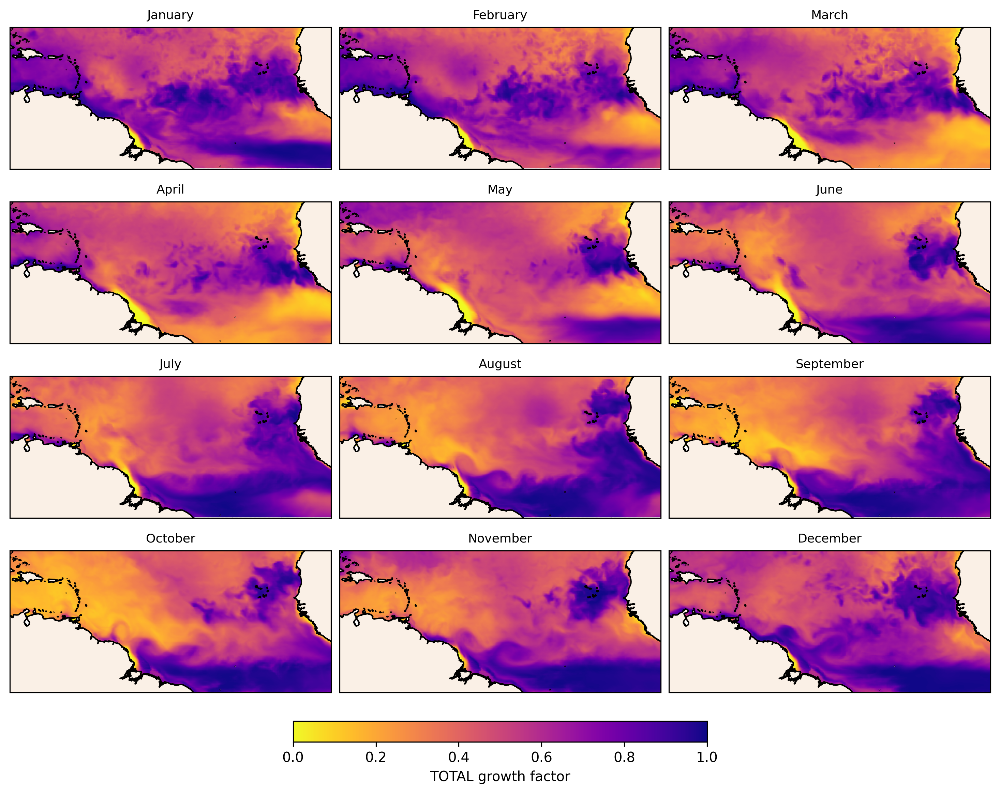

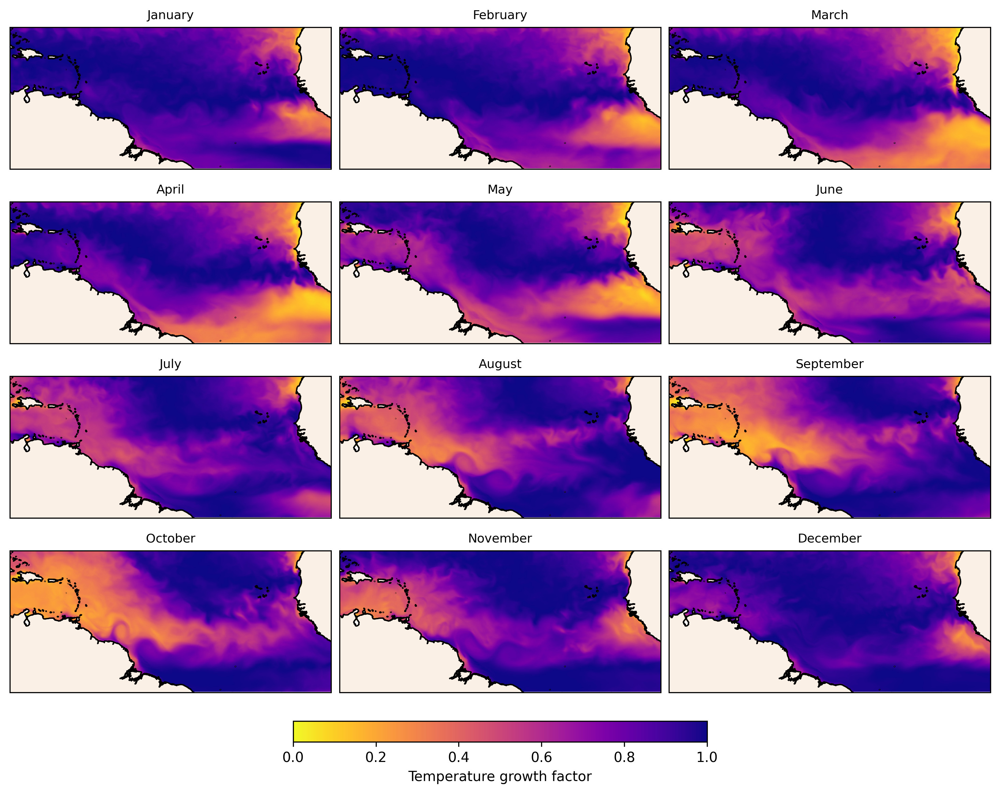

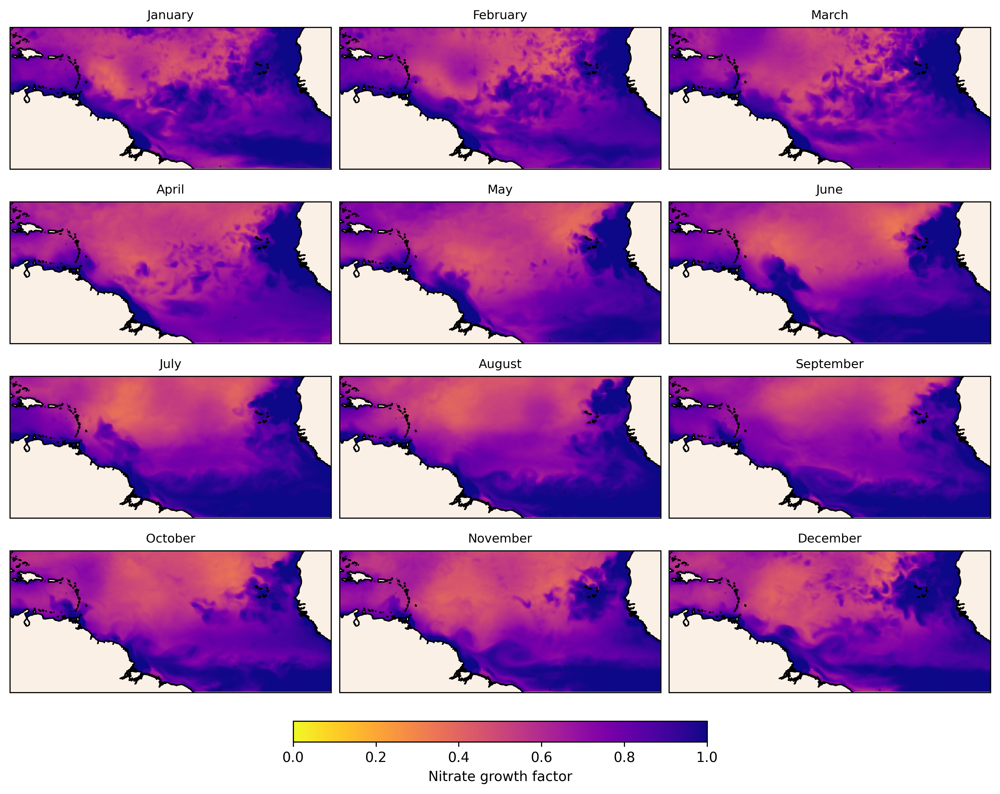

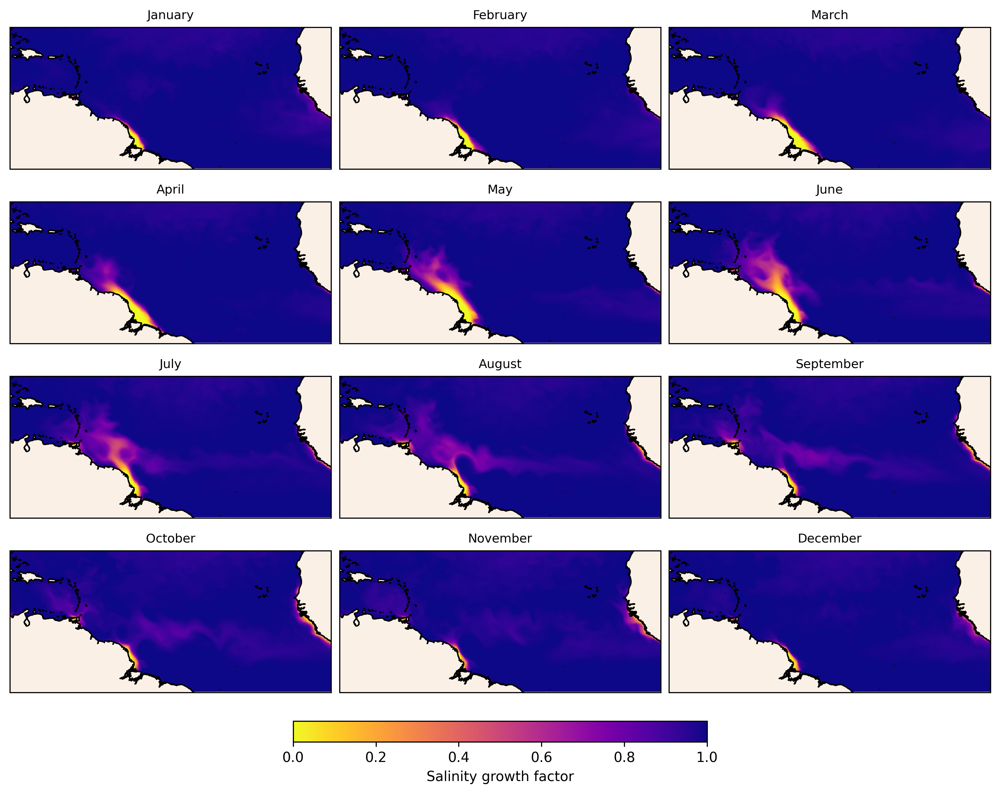

In [28]:
#GROWTH FACTOR PLOTS
import warnings
warnings.filterwarnings("ignore", message="facecolor will have no effect")

growth_factors = ['TOTAL', 'Temperature', 'Nitrate', 'Salinity']
growth_factor_data = [ timemean_lim_E_tot , timemean_lim_temp , timemean_lim_no3, timemean_lim_sal ]

for Y in range(len(growth_factors)):
    #FIGURE SETTINGS
    # fig, axes = plt.subplots(3,4,     # 3 rows × 4 columns
    #     figsize=(12,6),
    fig, axes = plt.subplots(4,3,     # 4 rows × 3 columns
        figsize=(10,8),
        dpi=290, constrained_layout=True, subplot_kw={'projection': ccrs.PlateCarree()})

    colormap = 'plasma_r'

    #Flattening axes array for loop
    axes = axes.flatten()

    #Plotting for each month
    for i, ax in enumerate(axes):
        ax.set_extent([-75, -10, -4, 21])
        ax.gridlines(draw_labels=False, alpha=0.3, linestyle='--', zorder=1)

        #Scatter plot for month i
        cscat = ax.scatter(
            DSEs[i].lon[:, -1], #loc
            DSEs[i].lat[:, -1], #loc
            #c=DSLs[i].biomass_difference[:, -1].values,
            c = growth_factor_data[Y][i,:],
            cmap=colormap, s=4, linewidth=0, transform=ccrs.PlateCarree(), zorder=2, 
            vmin=0.0, vmax=1
            )

        #Coastlines, land & subfigure title per month i
        ax.add_feature(cartopy.feature.LAND.with_scale('10m'), facecolor='linen', edgecolor='none', zorder=2)
        ax.add_feature(cartopy.feature.COASTLINE.with_scale('10m'), zorder=3)
        ax.set_title(months[i], fontsize=9)

    #Colorbar and title for all months
    cbar = fig.colorbar(
        cscat, ax=axes, orientation='horizontal', fraction=0.03, pad=0.04, label=f'{growth_factors[Y]} growth factor')
    #fig.suptitle(f'{growth_factors[Y]} growth factor averaged over EULERIAN simulations of 1 month  ', fontsize = 14)
    plt.savefig(f"/nethome/6903894/testing/THESIS_PLOTS/growth_factor_plot_{growth_factors[Y]}_thesis_f.pdf", format="pdf", bbox_inches="tight")
    plt.savefig(f"/nethome/6903894/testing/THESIS_PLOTS/growth_factor_plot_{growth_factors[Y]}_thesis_f.png", format="png", bbox_inches="tight")
    #plt.show()

Dataset TOTAL shape = (12,)
Dataset Temperature shape = (12,)
Dataset Nitrate shape = (12,)
Dataset Salinity shape = (12,)


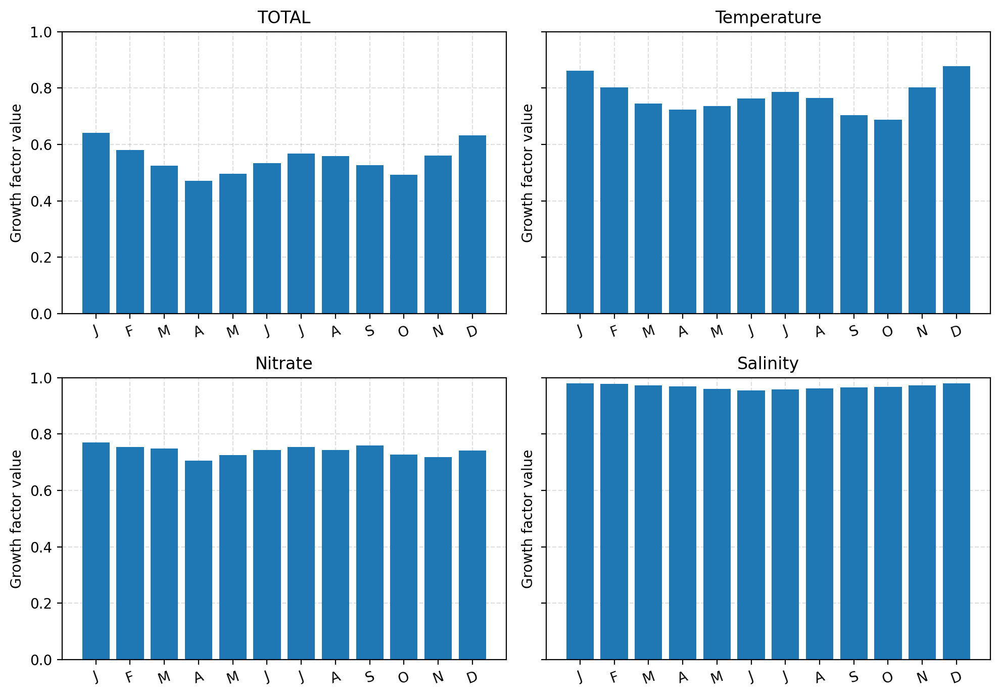

In [53]:
growth_factor_mean = [ mean_lim_E_tot , mean_lim_temp , mean_lim_no3, mean_lim_sal ]

months_short = ['J', 'F', 'M', 'A', 'M', 'J', 'J', 'A', 'S', 'O', 'N', 'D' ]

fig, axes = plt.subplots(2, 2, figsize=(10,7), sharey=True, dpi=200)
axes = axes.flatten()

for i, ax in enumerate(axes):
    data = np.squeeze(growth_factor_mean[i])

    print("Dataset", growth_factors[i], "shape =", data.shape)
    
    ax.bar(months, data,zorder=2)
    
    ax.set_title(growth_factors[i])
    ax.set_xticks(months)
    ax.set_xticklabels(months_short, rotation=20)
    #ax.set_xlabel("Month")
    ax.set_ylabel("Growth factor value")
    ax.grid(True, linestyle='--', alpha=0.4, zorder=1)
    ax.set_ylim(0,1)

fig.tight_layout()
plt.show()

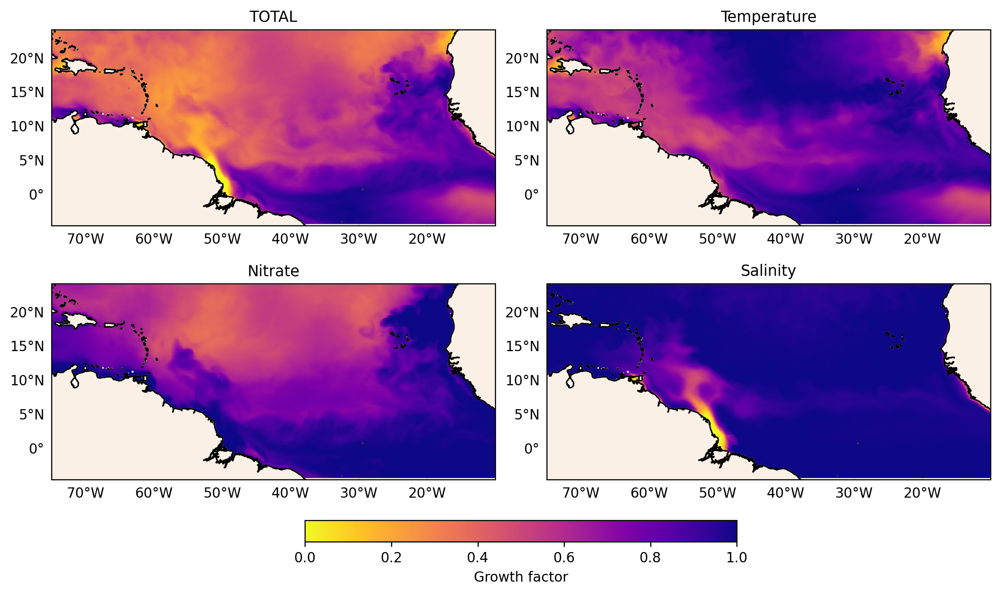

In [27]:
timemeans = [timemean_lim_E_tot, timemean_lim_temp, timemean_lim_no3, timemean_lim_sal]

month = 6

timemeans_month =  [T[month,:]  for T in timemeans] 

timemeans_month = np.array(timemeans_month)

Titles = ['TOTAL', 'Temperature', 'Nitrate', 'Salinity']

#FIGURE SETTINGS
fig, axes = plt.subplots(2,2,     # 3 rows × 4 columns
    figsize=(10,6),
    dpi=240, constrained_layout=True, subplot_kw={'projection': ccrs.PlateCarree()})
colormap = cmo.tempo_r
colormap2 = cmo.tools.crop_by_percent(colormap, 12, which='max', N=None)
colormap3 = 'plasma_r'

#Flattening axes array for loop
axes = axes.flatten()

#Plotting for each month
for i, ax in enumerate(axes):
    ax.set_extent([-75, -10, -4, 21])
    ax.gridlines(draw_labels=['left','bottom'], alpha=0.3, linestyle='--', zorder=1)

    #Scatter plot for month i
    cscat = ax.scatter(
        DSEs[i].lon[:, -1], #loc
        DSEs[i].lat[:, -1], #loc
        #c=DSLs[i].biomass_difference[:, -1].values,
        c = timemeans_month[i,:],
        cmap=colormap3, s=4, linewidth=0, transform=ccrs.PlateCarree(), zorder=2, 
        vmin=0.0, vmax=1
        )

    #Coastlines, land & subfigure title per month i
    ax.add_feature(cartopy.feature.COASTLINE.with_scale('10m'), zorder=3, color='black')
    ax.add_feature(cartopy.feature.LAND.with_scale('10m'), zorder=2, color='linen')
    ax.set_title(Titles[i], fontsize=11)

#Colorbar and title for all months
cbar = fig.colorbar(
    cscat, ax=axes, orientation='horizontal', fraction=0.045, pad=0.04, label='Growth factor'
    ,
    )
#fig.suptitle(f'Growth factors averaged over EULERIAN simulations of July 2024 ', fontsize = 14)
#fig.suptitle(f'July 2024 ', fontsize = 14)
# 
# 
plt.savefig(f"/nethome/6903894/testing/THESIS_PLOTS/growth_factor_plot_july_f2.pdf", format="pdf", bbox_inches="tight")
plt.savefig(f"/nethome/6903894/testing/THESIS_PLOTS/growth_factor_plot_july_f2.png", format="png", bbox_inches="tight")
plt.show()

In [4]:
#ANALYZING THE DIFFERENT CONTRIBUTIONS OF CURRENTS, STOKES AND WIND ON THE PARTICLES

#Preparing
#Multiplying surface stokes drift with local decay factor
for X in DSLs:
    X["speed_stokes_decay"] = X['speed_stokes'] * X['decay_factor']

print(DSL1.speed_currents.dims)

#Calculating mean of whole dataset 
mean_currents =     [X['speed_currents'].mean()    for X in DSLs] 
mean_stokes =       [X['speed_stokes_decay'].mean()      for X in DSLs] 
mean_wind =         [X['speed_wind'].mean()        for X in DSLs] 

#Calculating the mean over time
obs_mean_currents = [X['speed_currents'].mean(dim='obs')   for X in DSLs] 
obs_mean_stokes =   [X['speed_stokes'].mean(dim='obs')     for X in DSLs] 
obs_mean_wind =     [X['speed_wind'].mean(dim='obs')       for X in DSLs] 

#Calculating the mean over trajectory 
traj_mean_currents =[X['speed_currents'].mean(dim='trajectory')  for X in DSLs] 
traj_mean_stokes =  [X['speed_stokes_decay'].mean(dim='trajectory')     for X in DSLs] 
traj_mean_wind =    [X['speed_wind'].mean(dim='trajectory')      for X in DSLs] 

#Calculating max of whole dataset 
max_currents =  [X['speed_currents'].max()     for X in DSLs] 
max_stokes =    [X['speed_stokes'].max()          for X in DSLs]
max_wind =      [X['speed_wind'].max()            for X in DSLs] 

print(np.shape(mean_currents))
print(type(mean_currents))
print(np.shape(obs_mean_currents))

print(len(traj_mean_stokes))
print('time: ', np.array(time_in_days).shape)


('trajectory', 'obs')
(12,)
<class 'list'>
(12, 49631)
12
time:  (49631, 372)


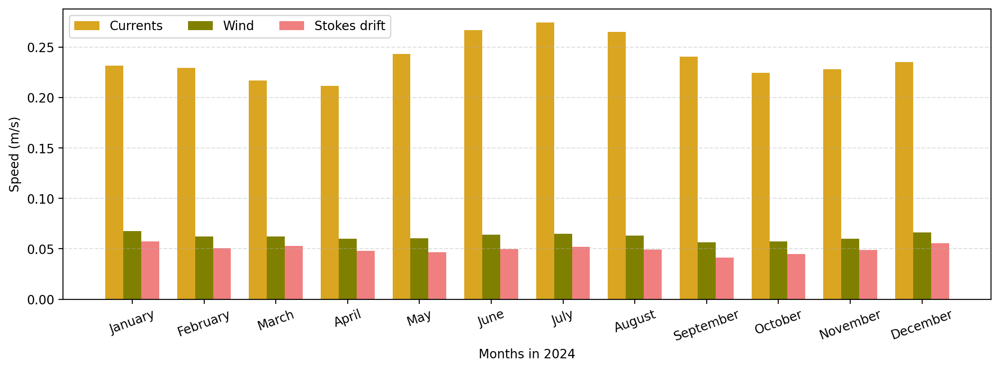

In [ ]:
#Defining MEAN velocities as dictionary
speed_means = {'Currents': mean_currents, 
               'Wind': mean_wind,
             'Stokes drift': mean_stokes  }

#Bar chart settings
x = np.arange(len(months))  # the label locations
width = 0.25  # the width of the bars
multiplier = 0
colors=['goldenrod', 'olive', 'lightcoral']

#FIGURE GROUPED BAR CHART
fig, ax = plt.subplots(figsize = (11,4),layout='constrained',dpi = 200)

#Looping over dictionary of means
for (attribute, measurement), c in zip(speed_means.items(), colors):
    offset = width * multiplier
    rects = ax.bar(x + offset, measurement, width, label=attribute, color=c)
    #ax.bar_label(rects, padding=2, fontsize=5, fmt='%.3f')
    multiplier += 1

#Figure settings
ax.set_ylabel('Speed (m/s)')
#ax.set_title('Monthly averaged instantaneous speed contributions')
ax.set_xticks(x + width)
ax.set_xticklabels(months, rotation=20)
ax.set_xlabel('Months in 2024')
ax.grid(axis='y', linestyle='--', alpha=0.4)
ax.legend(  loc='upper left', ncols=3)
plt.savefig(f"/nethome/6903894/testing/THESIS_PLOTS/speed_cont_12months.pdf", format="pdf", bbox_inches="tight")
plt.savefig(f"/nethome/6903894/testing/THESIS_PLOTS/speed_cont_12months.png", format="png", bbox_inches="tight")
plt.show()